In [1]:
# Import our dependencies
import pandas as pd
from sklearn.cluster import KMeans
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler,OneHotEncoder
import tensorflow as tf
import plotly.express as px
import hvplot.pandas

import warnings
warnings.filterwarnings('ignore')

In [2]:
# Read the cleansed Orders dataset
file_path = "../instacart-data/products.csv"
products_df = pd.read_csv(file_path)
products_df.head()

# Drop Null Values from datasets
products_df.dropna()

,product_id,product_name,aisle_id,department_id
0,1,Chocolate Sandwich Cookies,61,19
1,2,All-Seasons Salt,104,13
2,3,Robust Golden Unsweetened Oolong Tea,94,7
3,4,Smart Ones Classic Favorites Mini Rigatoni Wit...,38,1
4,5,Green Chile Anytime Sauce,5,13
...,...,...,...,...
49683,49684,"Vodka, Triple Distilled, Twist of Vanilla",124,5
49684,49685,En Croute Roast Hazelnut Cranberry,42,1
49685,49686,Artisan Baguette,112,3
49686,49687,Smartblend Healthy Metabolism Dry Cat Food,41,8


In [3]:
# Read the Department dataset
file_path = "../instacart-data/departments.csv"
dept_df = pd.read_csv(file_path)
dept_df.head()

# Drop Null Values from datasets
dept_df.dropna()

,department_id,department
0,1,frozen
1,2,other
2,3,bakery
3,4,produce
4,5,alcohol
5,6,international
6,7,beverages
7,8,pets
8,9,dry goods pasta
9,10,bulk


In [4]:
# Read the Department dataset
file_path = "../instacart-data/aisles.csv"
aisles_df = pd.read_csv(file_path)
aisles_df.head()

# Drop Null Values from datasets
aisles_df.dropna()

,aisle_id,aisle
0,1,prepared soups salads
1,2,specialty cheeses
2,3,energy granola bars
3,4,instant foods
4,5,marinades meat preparation
...,...,...
129,130,hot cereal pancake mixes
130,131,dry pasta
131,132,beauty
132,133,muscles joints pain relief


In [5]:
# using pandas to execute SQL queries
# Import dependencies
from sqlalchemy import create_engine
from config import db_password
import psycopg2

#Create a connection to the RDS instance
connection = psycopg2.connect(
    host = 'instacart-db.crrysho2rjsv.us-east-2.rds.amazonaws.com',
    port = 5432,
    user = 'postgres',
    password = 'G3DBpsW0rd',
    database='instacart'
    )
cursor=connection.cursor()

In [6]:
# using pandas to execute SQL queries
# Get the number of Reorders by product from the database table
sql = "select product_id, num_of_reorders from reorders_by_product"
reordprod_df = pd.read_sql(sql, con=connection)
reordprod_df

,product_id,num_of_reorders
0,24852,16557
1,13176,13362
2,21137,8603
3,21903,8055
4,47766,6226
...,...,...
39118,10871,0
39119,15256,0
39120,1792,0
39121,33246,0


In [7]:
# using pandas to execute SQL queries
# Get the number of Orders by product from the database table
sql = "select product_id, num_of_orders from orders_by_product"
orders_prod_df = pd.read_sql(sql, con=connection)
orders_prod_df

,product_id,num_of_orders
0,24852,18726
1,13176,15480
2,21137,10894
3,21903,9784
4,47626,8135
...,...,...
39118,46000,1
39119,45995,1
39120,46205,1
39121,45993,1


In [8]:
# Join the products and deaprtments, aisles datasets
products_df = products_df.merge(dept_df, on="department_id", how="left")
products_df

,product_id,product_name,aisle_id,department_id,department
0,1,Chocolate Sandwich Cookies,61,19,snacks
1,2,All-Seasons Salt,104,13,pantry
2,3,Robust Golden Unsweetened Oolong Tea,94,7,beverages
3,4,Smart Ones Classic Favorites Mini Rigatoni Wit...,38,1,frozen
4,5,Green Chile Anytime Sauce,5,13,pantry
...,...,...,...,...,...
49683,49684,"Vodka, Triple Distilled, Twist of Vanilla",124,5,alcohol
49684,49685,En Croute Roast Hazelnut Cranberry,42,1,frozen
49685,49686,Artisan Baguette,112,3,bakery
49686,49687,Smartblend Healthy Metabolism Dry Cat Food,41,8,pets


In [9]:
# Join the products and deaprtments, aisles datasets
products_df = products_df.merge(aisles_df, on="aisle_id", how="left")
products_df

,product_id,product_name,aisle_id,department_id,department,aisle
0,1,Chocolate Sandwich Cookies,61,19,snacks,cookies cakes
1,2,All-Seasons Salt,104,13,pantry,spices seasonings
2,3,Robust Golden Unsweetened Oolong Tea,94,7,beverages,tea
3,4,Smart Ones Classic Favorites Mini Rigatoni Wit...,38,1,frozen,frozen meals
4,5,Green Chile Anytime Sauce,5,13,pantry,marinades meat preparation
...,...,...,...,...,...,...
49683,49684,"Vodka, Triple Distilled, Twist of Vanilla",124,5,alcohol,spirits
49684,49685,En Croute Roast Hazelnut Cranberry,42,1,frozen,frozen vegan vegetarian
49685,49686,Artisan Baguette,112,3,bakery,bread
49686,49687,Smartblend Healthy Metabolism Dry Cat Food,41,8,pets,cat food care


In [10]:
# Join the Reorders and Orders dataset
products_df = products_df.merge(reordprod_df, on="product_id", how="left")
products_df

,product_id,product_name,aisle_id,department_id,department,aisle,num_of_reorders
0,1,Chocolate Sandwich Cookies,61,19,snacks,cookies cakes,49.0
1,2,All-Seasons Salt,104,13,pantry,spices seasonings,1.0
2,3,Robust Golden Unsweetened Oolong Tea,94,7,beverages,tea,6.0
3,4,Smart Ones Classic Favorites Mini Rigatoni Wit...,38,1,frozen,frozen meals,14.0
4,5,Green Chile Anytime Sauce,5,13,pantry,marinades meat preparation,1.0
...,...,...,...,...,...,...,...
49683,49684,"Vodka, Triple Distilled, Twist of Vanilla",124,5,alcohol,spirits,NaN
49684,49685,En Croute Roast Hazelnut Cranberry,42,1,frozen,frozen vegan vegetarian,NaN
49685,49686,Artisan Baguette,112,3,bakery,bread,5.0
49686,49687,Smartblend Healthy Metabolism Dry Cat Food,41,8,pets,cat food care,0.0


In [11]:
# Join the products and deaprtments, aisles datasets
products_df = products_df.merge(orders_prod_df, on="product_id", how="left")
products_df

,product_id,product_name,aisle_id,department_id,department,aisle,num_of_reorders,num_of_orders
0,1,Chocolate Sandwich Cookies,61,19,snacks,cookies cakes,49.0,76.0
1,2,All-Seasons Salt,104,13,pantry,spices seasonings,1.0,4.0
2,3,Robust Golden Unsweetened Oolong Tea,94,7,beverages,tea,6.0,6.0
3,4,Smart Ones Classic Favorites Mini Rigatoni Wit...,38,1,frozen,frozen meals,14.0,22.0
4,5,Green Chile Anytime Sauce,5,13,pantry,marinades meat preparation,1.0,1.0
...,...,...,...,...,...,...,...,...
49683,49684,"Vodka, Triple Distilled, Twist of Vanilla",124,5,alcohol,spirits,NaN,NaN
49684,49685,En Croute Roast Hazelnut Cranberry,42,1,frozen,frozen vegan vegetarian,NaN,NaN
49685,49686,Artisan Baguette,112,3,bakery,bread,5.0,7.0
49686,49687,Smartblend Healthy Metabolism Dry Cat Food,41,8,pets,cat food care,0.0,1.0


In [12]:
products_df.num_of_orders.fillna(0, inplace=True)
products_df

,product_id,product_name,aisle_id,department_id,department,aisle,num_of_reorders,num_of_orders
0,1,Chocolate Sandwich Cookies,61,19,snacks,cookies cakes,49.0,76.0
1,2,All-Seasons Salt,104,13,pantry,spices seasonings,1.0,4.0
2,3,Robust Golden Unsweetened Oolong Tea,94,7,beverages,tea,6.0,6.0
3,4,Smart Ones Classic Favorites Mini Rigatoni Wit...,38,1,frozen,frozen meals,14.0,22.0
4,5,Green Chile Anytime Sauce,5,13,pantry,marinades meat preparation,1.0,1.0
...,...,...,...,...,...,...,...,...
49683,49684,"Vodka, Triple Distilled, Twist of Vanilla",124,5,alcohol,spirits,NaN,0.0
49684,49685,En Croute Roast Hazelnut Cranberry,42,1,frozen,frozen vegan vegetarian,NaN,0.0
49685,49686,Artisan Baguette,112,3,bakery,bread,5.0,7.0
49686,49687,Smartblend Healthy Metabolism Dry Cat Food,41,8,pets,cat food care,0.0,1.0


In [13]:
products_df.num_of_reorders.fillna(0, inplace=True)
products_df

,product_id,product_name,aisle_id,department_id,department,aisle,num_of_reorders,num_of_orders
0,1,Chocolate Sandwich Cookies,61,19,snacks,cookies cakes,49.0,76.0
1,2,All-Seasons Salt,104,13,pantry,spices seasonings,1.0,4.0
2,3,Robust Golden Unsweetened Oolong Tea,94,7,beverages,tea,6.0,6.0
3,4,Smart Ones Classic Favorites Mini Rigatoni Wit...,38,1,frozen,frozen meals,14.0,22.0
4,5,Green Chile Anytime Sauce,5,13,pantry,marinades meat preparation,1.0,1.0
...,...,...,...,...,...,...,...,...
49683,49684,"Vodka, Triple Distilled, Twist of Vanilla",124,5,alcohol,spirits,0.0,0.0
49684,49685,En Croute Roast Hazelnut Cranberry,42,1,frozen,frozen vegan vegetarian,0.0,0.0
49685,49686,Artisan Baguette,112,3,bakery,bread,5.0,7.0
49686,49687,Smartblend Healthy Metabolism Dry Cat Food,41,8,pets,cat food care,0.0,1.0


In [ ]:
# Total Orders and Reorders Graph

In [ ]:
# We should probably include them so that we have a cluster of products having less orders
#products_df = products_df.loc[products_df.num_of_orders > 5] 
#products_df

In [ ]:
# We should probably include them so that we have a cluster of products having less orders
#products_df = products_df.loc[products_df.num_of_reorders > 1]
#products_df

In [14]:
prod_save_df = products_df.copy()
products_df.drop(columns=["product_name", "aisle_id", "department_id", "product_id"], inplace=True)
products_df

,department,aisle,num_of_reorders,num_of_orders
0,snacks,cookies cakes,49.0,76.0
1,pantry,spices seasonings,1.0,4.0
2,beverages,tea,6.0,6.0
3,frozen,frozen meals,14.0,22.0
4,pantry,marinades meat preparation,1.0,1.0
...,...,...,...,...
49683,alcohol,spirits,0.0,0.0
49684,frozen,frozen vegan vegetarian,0.0,0.0
49685,bakery,bread,5.0,7.0
49686,pets,cat food care,0.0,1.0


In [15]:
# Use get_dummies() to create variables for text features.
X = pd.get_dummies(products_df, columns=["department", "aisle"])
#X = X[0:100]
X

,num_of_reorders,num_of_orders,department_alcohol,department_babies,department_bakery,department_beverages,department_breakfast,department_bulk,department_canned goods,department_dairy eggs,...,aisle_spreads,aisle_tea,aisle_tofu meat alternatives,aisle_tortillas flat bread,aisle_trail mix snack mix,aisle_trash bags liners,aisle_vitamins supplements,aisle_water seltzer sparkling water,aisle_white wines,aisle_yogurt
0,49.0,76.0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,1.0,4.0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,6.0,6.0,0,0,0,1,0,0,0,0,...,0,1,0,0,0,0,0,0,0,0
3,14.0,22.0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,1.0,1.0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49683,0.0,0.0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
49684,0.0,0.0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
49685,5.0,7.0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
49686,0.0,1.0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [16]:
# Elbow curve for Products dataset
inertia = []
k = list(range(1, 11))

# Calculate the inertia for the range of K values
for i in k:
   km = KMeans(n_clusters=i, random_state=0)
   km.fit(X)
   inertia.append(km.inertia_)

# Define a DataFrame to plot the Elbow Curve using hvPlot
elbow_data = {"k": k, "inertia": inertia}
df_elbow = pd.DataFrame(elbow_data)
df_elbow.hvplot.line(x="k", y="inertia", title="Elbow Curve - Products", xticks=k)

:Curve   [k]   (inertia)

In [17]:
# Initialize the K-Means model; Use k=5 from the Elbow curve
kmeans_model = KMeans(n_clusters=5, random_state=0)
kmeans_model
    
# Fit the model
kmeans_model.fit(X)

# Predict clusters
predictions = kmeans_model.predict(X)
predictions

array([0, 0, 0, ..., 0, 0, 0])

In [18]:
# Create a new DataFrame including predicted clusters and Products features.
clustered_df = pd.DataFrame(prod_save_df)

#  Add a new column, "Class" to the clustered_df DataFrame that holds the predictions.
clustered_df["Class"] = predictions 

# Print the shape of the clustered_df
print(clustered_df.shape)
clustered_df.head(10)

(49688, 9)


,product_id,product_name,aisle_id,department_id,department,aisle,num_of_reorders,num_of_orders,Class
0,1,Chocolate Sandwich Cookies,61,19,snacks,cookies cakes,49.0,76.0,0
1,2,All-Seasons Salt,104,13,pantry,spices seasonings,1.0,4.0,0
2,3,Robust Golden Unsweetened Oolong Tea,94,7,beverages,tea,6.0,6.0,0
3,4,Smart Ones Classic Favorites Mini Rigatoni Wit...,38,1,frozen,frozen meals,14.0,22.0,0
4,5,Green Chile Anytime Sauce,5,13,pantry,marinades meat preparation,1.0,1.0,0
5,6,Dry Nose Oil,11,11,personal care,cold flu allergy,0.0,0.0,0
6,7,Pure Coconut Water With Orange,98,7,beverages,juice nectars,1.0,1.0,0
7,8,Cut Russet Potatoes Steam N' Mash,116,1,frozen,frozen produce,7.0,13.0,0
8,9,Light Strawberry Blueberry Yogurt,120,16,dairy eggs,yogurt,2.0,5.0,0
9,10,Sparkling Orange Juice & Prickly Pear Beverage,115,7,beverages,water seltzer sparkling water,70.0,119.0,0


In [22]:
clustered_df.Class.value_counts()

0    48942
3      663
4       72
1        9
2        2
Name: Class, dtype: int64

In [ ]:
clustered_df.num_of_reorders.describe()

# Products are grouped into 5 clusters -
- Class 0 - never re-ordered
- Class 1 - rarely re-ordered
- Class 2 - occasionally re-ordered
- Class 3 - often re-ordered 
- Class 4 - frequentlly re-ordered or Popular 

In [26]:
# Create a hvplot.scatter plot 
clustered_df.hvplot.scatter(x="num_of_reorders", y="num_of_orders", by="Class")

:NdOverlay   [Class]
   :Scatter   [num_of_reorders]   (num_of_orders)

In [20]:
# Creating a 3D-Scatter with the data and the clusters
fig = px.scatter_3d(
    clustered_df,
    x="product_id",
    y="num_of_orders",
    z="num_of_reorders",
    hover_name = "aisle",
    hover_data =  ["department"],
    color="Class",
    symbol="Class",
    width=800,
)
fig.update_layout(legend=dict(x=0, y=1))
fig.show()


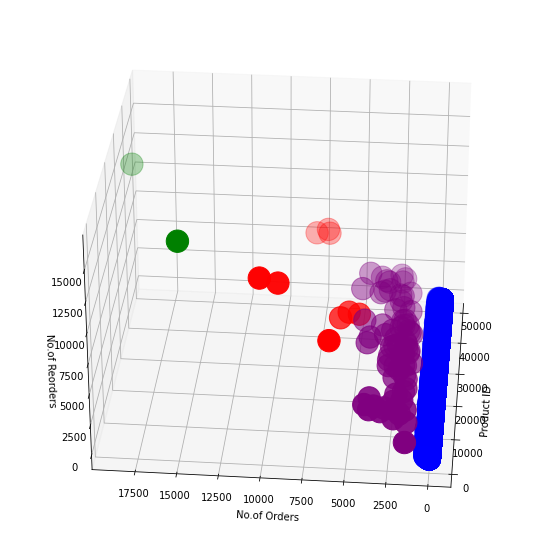

In [21]:
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
 
fig = plt.figure(figsize=(20,10))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(clustered_df.product_id[clustered_df.Class == 0], clustered_df["num_of_orders"][clustered_df.Class == 0], clustered_df["num_of_reorders"][clustered_df.Class == 0], c='blue', s=500)
ax.scatter(clustered_df.product_id[clustered_df.Class == 1], clustered_df["num_of_orders"][clustered_df.Class == 1], clustered_df["num_of_reorders"][clustered_df.Class == 1], c='red', s=500)
ax.scatter(clustered_df.product_id[clustered_df.Class == 2], clustered_df["num_of_orders"][clustered_df.Class == 2], clustered_df["num_of_reorders"][clustered_df.Class == 2], c='green', s=500)#ax.scatter(clustered_df.product_id[clustered_df.Class == 3], clustered_df["num_of_orders"][clustered_df.Class == 3], clustered_df["num_of_reorders"][clustered_df.Class == 3], c='orange', s=500)
ax.scatter(clustered_df.product_id[clustered_df.Class == 4], clustered_df["num_of_orders"][clustered_df.Class == 4], clustered_df["num_of_reorders"][clustered_df.Class == 4], c='purple', s=500)
ax.view_init(30, 185)
plt.xlabel("Product ID")
plt.ylabel("No.of Orders")
ax.set_zlabel('No.of Reorders')
plt.show()

# Let's try using Principal Component Analysis

In [27]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

# Standardize the data with StandardScaler().
products_df_scaled = StandardScaler().fit_transform(X)
products_df_scaled[0:5]

# Using PCA to reduce dimension to three principal components.
pca = PCA(n_components=3)
products_pca = pca.fit_transform(X)
products_pca

array([[ 5.78540629e+01, -3.78259609e+00,  7.71736704e-01],
       [-2.84756398e+01,  2.14789172e+00, -6.23979090e-03],
       [-2.38393223e+01,  4.88842436e+00,  1.02280319e-03],
       ...,
       [-2.36576684e+01,  3.48544412e+00,  7.70565172e-04],
       [-3.14622581e+01,  3.18793582e+00,  1.61575922e-03],
       [-2.84756689e+01,  2.14965150e+00, -6.86493361e-01]])

In [28]:
# Create a DataFrame with the three principal components.
pcs_df = pd.DataFrame(data=products_pca, columns=["PC 1", "PC 2", "PC 3"], index=None)
pcs_df

,PC 1,PC 2,PC 3
0,57.854063,-3.782596,0.771737
1,-28.475640,2.147892,-0.006240
2,-23.839322,4.888424,0.001023
3,-6.282759,1.457532,-0.002851
4,-30.851848,3.979302,-0.004625
...,...,...,...
49683,-32.254326,3.798298,0.001857
49684,-32.254321,3.797925,-0.000649
49685,-23.657668,3.485444,0.000771
49686,-31.462258,3.187936,0.001616


In [29]:
# Create an elbow curve to find the best value for K.
inertia = []
k = list(range(1, 11))

# Calculate the inertia for the range of K values
for i in k:
   km = KMeans(n_clusters=i, random_state=0)
   km.fit(pcs_df)
   inertia.append(km.inertia_)

elbow_data = {"k": k, "inertia": inertia}
df_elbow = pd.DataFrame(elbow_data)
df_elbow.hvplot.line(x="k", y="inertia", title="Elbow Curve", xticks=k)

:Curve   [k]   (inertia)

In [30]:
# Initialize the K-Means model; Use k=4 from the Elbow curve
kmeans_model = KMeans(n_clusters=5, random_state=0)
kmeans_model
    
# Fit the model
kmeans_model.fit(pcs_df)

# Predict clusters
predictions = kmeans_model.predict(pcs_df)
predictions

array([0, 0, 0, ..., 0, 0, 0])

In [33]:
# Create a new DataFrame including predicted clusters and cryptocurrencies features.
# Concatentate the crypto_df and pcs_df DataFrames on the same columns.
clustered_df = prod_save_df.join(pcs_df)

#  Add a new column, "Class" to the clustered_df DataFrame that holds the predictions.
clustered_df["Class"] = predictions 

# Print the shape of the clustered_df
print(clustered_df.shape)
clustered_df.head(10)

(49688, 12)


,product_id,product_name,aisle_id,department_id,department,aisle,num_of_reorders,num_of_orders,Class,PC 1,PC 2,PC 3
0,1,Chocolate Sandwich Cookies,61,19,snacks,cookies cakes,49.0,76.0,0,57.854063,-3.782596,0.771737
1,2,All-Seasons Salt,104,13,pantry,spices seasonings,1.0,4.0,0,-28.475640,2.147892,-0.006240
2,3,Robust Golden Unsweetened Oolong Tea,94,7,beverages,tea,6.0,6.0,0,-23.839322,4.888424,0.001023
3,4,Smart Ones Classic Favorites Mini Rigatoni Wit...,38,1,frozen,frozen meals,14.0,22.0,0,-6.282759,1.457532,-0.002851
4,5,Green Chile Anytime Sauce,5,13,pantry,marinades meat preparation,1.0,1.0,0,-30.851848,3.979302,-0.004625
5,6,Dry Nose Oil,11,11,personal care,cold flu allergy,0.0,0.0,0,-32.254381,3.799308,-0.700972
6,7,Pure Coconut Water With Orange,98,7,beverages,juice nectars,1.0,1.0,0,-30.851820,3.980187,0.000684
7,8,Cut Russet Potatoes Steam N' Mash,116,1,frozen,frozen produce,7.0,13.0,0,-17.684394,1.406679,-0.002623
8,9,Light Strawberry Blueberry Yogurt,120,16,dairy eggs,yogurt,2.0,5.0,0,-27.073045,2.329816,-0.003460
9,10,Sparkling Orange Juice & Prickly Pear Beverage,115,7,beverages,water seltzer sparkling water,70.0,119.0,0,104.732149,-13.397606,-0.012094


In [41]:
# Creating a 3D-Scatter with the PCA data and the clusters
fig = px.scatter_3d(
    clustered_df,
    x="PC 1",
    y="PC 2",
    z="PC 3",
    hover_name = "product_name",
    hover_data =  ["department", "aisle", "num_of_orders", "num_of_reorders"],
    color="Class",
    symbol="Class",
    width=800,
)
fig.update_layout(legend=dict(x=0, y=1))
fig.show()


# Hierarchical Clustering

In [ ]:
import plotly.figure_factory as ff
# Create the dendrogram
fig = ff.create_dendrogram(products_pca, color_threshold=0)
fig.update_layout(width=800, height=500)
fig.show()

In [ ]:
from sklearn.cluster import AgglomerativeClustering

agg = AgglomerativeClustering(n_clusters=3)
model = agg.fit(products_pca)

# Add the predicted class columns
aggclustered_df["class"] = model.labels_
df.head()

aggclustered_df.hvplot.scatter(
    x="principal component 1",
    y="principal component 2",
    hover_cols=["class"],
    by="class",
)
